___
# Introducción Google Colab
___



# Celdas de Código


La celda de abajo es una celda de código. 

Una vez en la esquina superior se indique que el entorno de ejecución está conectado, usted puede ejecutar el código de la celda con el botón PLAY. También puede usar la combinación **Shift+Enter**

In [2]:
print('hola')

hola


In [3]:
# Este es un comentario
a = 3
b = 4
c = a + b
print(c)

7


# Celdas de Texto

Esta es una  **celda de texto**. Dando **doble-click** puede editar el contenido de la celda. 

Las celdas de texto usa sintaxis de marcado, esto quiere decir que podemos combinar texto con código HTML o LATEX, si quiere conocer un poco más siga el siguiente link  [markdown
guide](/notebooks/markdown_guide.ipynb).

Latex es el lenguaje más conocido para escribir expresiones matemáticas [LaTeX](http://www.latex-project.org/). Para incluir fórmulas u otras expresiones matemátcas use un par de signos  **\$** . 

Por ejemplo `$\sqrt{3x-1}+(1+x)^2$` se visualiza así:

$\sqrt{3x-1}+(1+x)^2$

---
# Ejercicio de análisis de datos de contratación pública
---

Presentado por:
Miguel Angel Sastoque 

## Problema de Negocio
Para el estado colombiano desde diferentes entidades (organos de control, ciudadanía, entidades, contratistas) es importante realizar un monitoreo de los procesos de contratación pública del país. Colombia Compra Eficiente es la etidad que se encarga de disponer la infraestructura para realizar los procesos de compra pública, los cuales se consolidan en SECOP I.  
Los datos se encuentran disponibles en Datos Abiertos. Para este ejercicio se utilzarán los datos de SECOP I de procesos de contratación, se tomarán datos del 2020.

*   https://www.datos.gov.co/Presupuestos-Gubernamentales/SECOP-I-2020/c82b-7jfi

___
# 01. Recolección de Datos
___
Vamos a recolectar la información a través de la API de Datos Abiertos


In [4]:
# instalación de librerias
!pip install sodapy
!pip install plotly
!pip install cufflinks

In [5]:
# Importación de librerias
import pandas as pd
from sodapy import Socrata
from datetime import date, datetime, timedelta
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

import cufflinks as cf
import plotly
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.express as px

print(f'cf = {cf.__version__}')
print(f'pd = {pd.__version__}')
print(f'plotly = {plotly.__version__}')
print(f'sns = {sns.__version__}')

# Datos de conexión con la API
token = None
client = Socrata("www.datos.gov.co", token, timeout=25)
ds_secop1 = "c82b-7jfi"    # SECOP I 2020 CARGUE DIARIO 

# Funciones
def dates_ini_fin (ini, fin):
    ''' Función que retorna lista de fechas desde fecha inicio hasta fecha fin
        dates_ini_fin ("2019-01-01","2019-01-20")
        Return = lista con fechas
    '''
    start = datetime.strptime(ini, "%Y-%m-%d")
    end = datetime.strptime(fin, "%Y-%m-%d")
    date_generated = [start + timedelta(days=x) for x in range(0, (end-start).days)]

    fechas = []
    for date in date_generated:
        fechas.append(date.strftime("%m/%d/%Y"))
    return fechas



cf = 0.17.3
pd = 1.1.4
plotly = 4.4.1
sns = 0.11.0


In [6]:
# Config how pandas show o screen
pd.options.display.max_rows = 200          # Numero de lineas
pd.options.display.max_columns = 100      # Número de columnas
pd.options.display.float_format = '{:,.1f}'.format    # formato presentación numeros
pd.set_option('display.max_colwidth', 100)   # Ancho de columnas
print('max rows = {}'.format(pd.get_option('max_rows')))
print('max columns = {}'.format(pd.get_option('max_columns')))

max rows = 200
max columns = 100


## Secop 1
Para el ejeccicio se toman los datos directamente de datos abiertos a travez de una API utilizando la libreria SODAPY, debido a que el conjunto de datos de SECOP es muy grande, se requiere hace una consulta por día.   
Se utilizan los parámetros ***f_ini*** para indicar la fecha inicial de descarga y ***f_fin*** para la fecha final.

In [7]:
select = """
         uid AS ID_CONTRATO,
            nombre_de_la_entidad AS NOMBRE_ENTIDAD,
            nit_de_la_entidad AS NIT_ENTIDAD,
            nivel_entidad AS NIVEL_ENTIDAD,
            tipo_de_proceso AS TIPO_PROCESO,
            tipo_de_contrato AS TIPO_CONTRATO,
            estado_del_proceso AS ESTADO_PROCESO,
            fecha_de_firma_del_contrato AS FECHA_SUSCRIPCION,
            numero_del_contrato AS NUMERO_CONTRATO,
            numero_de_proceso AS NUMERO_PROCESO,
            cuantia_contrato AS VALOR_CONTRATO,
            detalle_del_objeto_a_contratar AS OBJETO_CONTRATO,
            nom_raz_social_contratista AS NOMBRE_CONTRATISTA,
            identificacion_del_contratista AS ID_CONTRATISTA,
            ruta_proceso_en_secop_i AS URL,
            origen_de_los_recursos AS ORIGEN_RECURSOS,
            cuantia_proceso AS VALOR_PROCESO,
            fecha_de_cargue_en_el_secop AS FECHA_PUBLICACION,
            anno_cargue_secop AS ANO_PUBLICACION,
            anno_firma_del_contrato AS ANO_SUSCRIPCION,
            id_objeto_a_contratar AS ID_OBJETO,
            identific_del_represen_legal AS ID_REP_LEGAL,
            nombre_del_represen_legal AS NOMBRE_REP_LEGAL,
            id_ajudicacion AS ID_ADJUDICACION,
            plazo_de_ejec_del_contrato AS PLAZO_DIAS,
            rango_de_ejec_del_contrato AS PLAZO_RANGO,
            municipio_entidad AS MUNICIPIO_ENTIDAD,
            departamento_entidad AS DEPARTAMENTO_ENTIDAD,
            municipios_ejecucion AS MUNICIPIO_EJECUCION,
            valor_total_de_adiciones AS VALOR_ADICIONES,
            valor_contrato_con_adiciones AS VALOR_TOTAL_CONTRATO,
            tiempo_adiciones_en_dias AS TIEMPO_ADICIONES,
            marcacion_adiciones AS MARCA_ADICIONES

"""

In [8]:
%%time
# Fechas descarga
f_ini = '2020-01-01'    # Cargue la fecha inicial de descarga
f_fin = '2020-02-01'    # Cargue la fecha final de descarga
fechas = dates_ini_fin(f_ini, f_fin)
  
print("==== SECOP I Contratos desde {} hasta {} ====".format(fechas[0],fechas[len(fechas)-1]))
results = []
for fecha in fechas:
  a = "fecha_de_cargue_en_el_secop ==" + "'" + fecha + "'"
  #print(a)
  res = client.get(ds_secop1,
                   select=select,
                   limit=100000,
                   where = a)
  results.extend(res)
  
  # Imprimir en Pantalla
  print('{} | {} | {}'.format(datetime.now(), fecha ,len(res)))
    
df = pd.DataFrame.from_records(results)
        
print("=== Total de registros {} ===".format(df.shape))

==== SECOP I Contratos desde 01/01/2020 hasta 01/31/2020 ====
2020-11-27 07:29:31.081694 | 01/01/2020 | 393
2020-11-27 07:29:31.570150 | 01/02/2020 | 3053
2020-11-27 07:29:35.069732 | 01/03/2020 | 3013
2020-11-27 07:29:35.244290 | 01/04/2020 | 878
2020-11-27 07:29:35.691679 | 01/05/2020 | 206
2020-11-27 07:29:35.948458 | 01/06/2020 | 1002
2020-11-27 07:29:36.837047 | 01/07/2020 | 3999
2020-11-27 07:29:37.368496 | 01/08/2020 | 4589
2020-11-27 07:29:37.850395 | 01/09/2020 | 4991
2020-11-27 07:29:38.536099 | 01/10/2020 | 4388
2020-11-27 07:29:40.015715 | 01/11/2020 | 863
2020-11-27 07:29:40.854543 | 01/12/2020 | 664
2020-11-27 07:29:41.203333 | 01/13/2020 | 3639
2020-11-27 07:29:41.791819 | 01/14/2020 | 3541
2020-11-27 07:29:42.506622 | 01/15/2020 | 5590
2020-11-27 07:29:42.965284 | 01/16/2020 | 4193
2020-11-27 07:29:47.703794 | 01/17/2020 | 3740
2020-11-27 07:29:47.866747 | 01/18/2020 | 786
2020-11-27 07:29:48.066960 | 01/19/2020 | 284
2020-11-27 07:29:48.800796 | 01/20/2020 | 4833
2020-

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100562 entries, 0 to 100561
Data columns (total 33 columns):
 #   Column                Non-Null Count   Dtype 
---  ------                --------------   ----- 
 0   ID_CONTRATO           100562 non-null  object
 1   NOMBRE_ENTIDAD        100562 non-null  object
 2   NIT_ENTIDAD           100562 non-null  object
 3   NIVEL_ENTIDAD         100562 non-null  object
 4   TIPO_PROCESO          100562 non-null  object
 5   TIPO_CONTRATO         100562 non-null  object
 6   ESTADO_PROCESO        100562 non-null  object
 7   FECHA_SUSCRIPCION     93341 non-null   object
 8   NUMERO_CONTRATO       100562 non-null  object
 9   NUMERO_PROCESO        100562 non-null  object
 10  VALOR_CONTRATO        100562 non-null  object
 11  OBJETO_CONTRATO       100562 non-null  object
 12  NOMBRE_CONTRATISTA    100562 non-null  object
 13  ID_CONTRATISTA        100562 non-null  object
 14  URL                   100562 non-null  object
 15  ORIGEN_RECURSOS  

In [10]:
df.head(5)

,ID_CONTRATO,NOMBRE_ENTIDAD,NIT_ENTIDAD,NIVEL_ENTIDAD,TIPO_PROCESO,TIPO_CONTRATO,ESTADO_PROCESO,FECHA_SUSCRIPCION,NUMERO_CONTRATO,NUMERO_PROCESO,VALOR_CONTRATO,OBJETO_CONTRATO,NOMBRE_CONTRATISTA,ID_CONTRATISTA,URL,ORIGEN_RECURSOS,VALOR_PROCESO,FECHA_PUBLICACION,ANO_PUBLICACION,ANO_SUSCRIPCION,ID_OBJETO,ID_REP_LEGAL,NOMBRE_REP_LEGAL,ID_ADJUDICACION,PLAZO_DIAS,PLAZO_RANGO,MUNICIPIO_ENTIDAD,DEPARTAMENTO_ENTIDAD,MUNICIPIO_EJECUCION,VALOR_ADICIONES,VALOR_TOTAL_CONTRATO,TIEMPO_ADICIONES,MARCA_ADICIONES
0,20-4-10247786-9380559,ANTIOQUIA - E.S.E. HOSPITAL SAN JUAN DE DIOS DE YARUMAL,890981726,TERRITORIAL,Régimen Especial,Prestación de Servicios,Celebrado,01/02/2020,CPS-017-2020,CPS-017-2020,78000000,TRANSPORTE,LINA MARIA MADRIGAL MARTINEZ,32561155,{'url': 'https://www.contratos.gov.co/consultas/detalleProceso.do?numConstancia=20-4-10247786'},"Recursos Propios (Alcaldías, Gobernaciones y Resguardos Indígenas)",78000000,01/01/2020,2020,2020,78000000,32561155,PROPIO 1,9380559,12,M,Yarumal,Antioquia,Antioquia - Yarumal,0,78000000,0,No
1,20-12-10247879-9380671,TOLIMA - ALCALDÍA MUNICIPIO DE EL ESPINAL,890702027,TERRITORIAL,Contratación Directa (Ley 1150 de 2007),Prestación de Servicios,Celebrado,11/15/2019,703,703-2019,3333333,PRESTACION DE SERVICIOS PROFESIONALES PARA EJECUTAR LAS ACCIONES CORRESPONDIENTES EN SALUD INCLU...,JERSON CAMILO BRAVO MONTENEGRO,1024528707,{'url': 'https://www.contratos.gov.co/consultas/detalleProceso.do?numConstancia=20-12-10247879'},No definido,3333333,01/01/2020,2020,2019,80000000,1024528707,JERSON CAMILO BRAVO MONTENEGRO,9380671,45,D,El Espinal,Tolima,Tolima - El Espinal,0,3333333,0,No
2,20-4-10247897-0,MAGDALENA - E.S.E CENTRO DE SALUD DE ZAPAYAN - ZAPAYAN,819004503,TERRITORIAL,Régimen Especial,Prestación de Servicios,Convocado,NaN,No definido,136,0,SUMINISTRO DE COMBUSTIBLE,No Definido,No Definido,{'url': 'https://www.contratos.gov.co/consultas/detalleProceso.do?numConstancia=20-4-10247897'},No definido,5000000,01/01/2020,2020,NaN,91000000,No Definido,No Definido,0,0,N,Zapayán,Magdalena,No definido,0,0,0,No
3,20-4-10247830-9380768,NORTE DE SANTANDER - UNIVERSIDAD FRANCISCO DE PAULA SANTANDER DE CÚCUTA,890500622,TERRITORIAL,Régimen Especial,Prestación de Servicios,Celebrado,01/01/2020,OPSF00005,OPS-F00005,1500000,PRESTACION DE SERVICIOS DE UN TECNOLOGO EN OBRAS CIVILES PARA EL DESARROLLO DE LAS DIFERENTES PR...,VEGA HERNANDEZ JOSE IGNACIO,13474088,{'url': 'https://www.contratos.gov.co/consultas/detalleProceso.do?numConstancia=20-4-10247830'},No definido,1500000,01/01/2020,2020,2020,80000000,13474088,VEGA HERNANDEZ JOSE IGNACIO,9380768,19,D,San José de Cúcuta,Norte De Santander,Norte De Santander - San José de Cúcuta,0,1500000,0,No
4,20-12-10247987-9380802,TOLIMA - ALCALDÍA MUNICIPIO DE EL ESPINAL,890702027,TERRITORIAL,Contratación Directa (Ley 1150 de 2007),Prestación de Servicios,Celebrado,11/15/2019,715,715-2019,1880000,PRESTACION DE SERVICIOS DE APOYO A LA GESTION PARA LA CONSERVACION PRESERVACION Y CUSTODIA DE L...,JENIFFER RODRIGUEZ PEREZ,1105683306,{'url': 'https://www.contratos.gov.co/consultas/detalleProceso.do?numConstancia=20-12-10247987'},No definido,1880000,01/01/2020,2020,2019,80000000,1105683306,JENIFFER RODRIGUEZ PEREZ,9380802,47,D,El Espinal,Tolima,Tolima - El Espinal,0,1880000,0,No


# Verificar Valores Nulos


In [11]:
df.isnull().sum()

ID_CONTRATO                0
NOMBRE_ENTIDAD             0
NIT_ENTIDAD                0
NIVEL_ENTIDAD              0
TIPO_PROCESO               0
TIPO_CONTRATO              0
ESTADO_PROCESO             0
FECHA_SUSCRIPCION       7221
NUMERO_CONTRATO            0
NUMERO_PROCESO             0
VALOR_CONTRATO             0
OBJETO_CONTRATO            0
NOMBRE_CONTRATISTA         0
ID_CONTRATISTA             0
URL                        0
ORIGEN_RECURSOS            0
VALOR_PROCESO              0
FECHA_PUBLICACION          0
ANO_PUBLICACION            0
ANO_SUSCRIPCION         7221
ID_OBJETO                  0
ID_REP_LEGAL               0
NOMBRE_REP_LEGAL           0
ID_ADJUDICACION            0
PLAZO_DIAS                 0
PLAZO_RANGO                0
MUNICIPIO_ENTIDAD          0
DEPARTAMENTO_ENTIDAD       0
MUNICIPIO_EJECUCION        0
VALOR_ADICIONES            0
VALOR_TOTAL_CONTRATO       0
TIEMPO_ADICIONES           0
MARCA_ADICIONES            0
dtype: int64

# Preparación de datos

In [12]:
# Declaración de Funciones de limpieza y preparación de datos

def mayus(cadena):
    res = str(cadena).upper().replace('.','').replace('?','').replace('¿','').replace('´','')\
                .replace('Á','A').replace('É','E').replace('Í','I').replace('Ó','O').replace('Ú','U')\
                .replace('','').replace('#','').replace(';','').replace('\n','').replace('\t','').replace('  ',' ')\
                .replace('^','').replace('Ç','').replace('¨','').replace('&','').replace('|','').replace('»','')
    return res.strip()

def modalidad(x):
  x = mayus(x)
  if x == 'ASOCIACION PUBLICO PRIVADA' : m = 'ASOCIACION PUBLICO PRIVADA'
  elif x == 'CONCURSO DE MERITOS ABIERTO' : m = 'CONCURSO DE MERITOS'
  elif x == 'CONTRATACION DIRECTA (LEY 1150 DE 2007)' : m = 'CONTRATACION DIRECTA'
  elif x == 'CONTRATACION MINIMA CUANTIA' : m = 'MINIMA CUANTIA'
  elif x == 'CONTRATOS Y CONVENIOS CON MAS DE DOS PARTES' : m = 'OTRAS FORMAS DE CONTRATACION DIRECTA'
  elif x == 'LICITACION OBRA PUBLICA' : m = 'LICITACION PUBLICA'
  elif x == 'LICITACION PUBLICA' : m = 'LICITACION PUBLICA'
  elif x == 'REGIMEN ESPECIAL' : m = 'OTRAS FORMAS DE CONTRATACION DIRECTA'
  elif x == 'SELECCION ABREVIADA DE MENOR CUANTIA (LEY 1150 DE 2007)' : m = 'SELECCION ABREVIADA'
  elif x == 'SELECCION ABREVIADA DEL LITERAL H DEL NUMERAL 2 DEL ARTICULO 2 DE LA LEY 1150 DE 2007' : m = 'SELECCION ABREVIADA'
  elif x == 'SELECCION ABREVIADA SERVICIOS DE SALUD' : m = 'SELECCION ABREVIADA'
  elif x == 'SUBASTA' : m = 'SELECCION ABREVIADA'
  else: m = 'OTRAS FORMAS DE CONTRATACION DIRECTA'
  return m

def origen_recursos(x):
  x = mayus(x)
  if x == 'RECURSOS DE CREDITO' : m = 'CREDITO'
  elif x == 'RECURSOS PROPIOS' : m = 'RECURSOS PROPIOS'
  elif x == 'REGALIAS' : m = 'SGR'
  elif x == 'SGP' : m = 'SGP'
  elif x == 'SGR' : m = 'SGR'
  else: m = 'NO DEFINIDO'
  return m

def tipo_contrato(x):
  m = mayus(x).replace('OTRO TIPO DE CONTRATO','OTRO').replace('NO DEFINIDO','OTRO').replace('AGREGACION DE DEMANDA','ACUERDO MARCO')
  return m

def link(x):
  if type(x) is dict:
    url = list(x.values())
  else:
    url = x
  url = url[0]
  return url 

def plazo(valor ,rango):
  if rango == 'M': 
    p = int(valor)*30 
  else: p = int(valor)
  return p


def tiempo_f(f1,f2):
  try:
    #f1 = datetime.strptime(str(f1), "%m/%d/%Y")
    #f2 = datetime.strptime(str(f2), "%m/%d/%Y")
    d = (f2 - f1).days
  except:
    d = 0
  return d 



In [13]:
%%time

df['FECHA_CONSULTA'] = pd.to_datetime('now') + pd.Timedelta('05:00:00')
df['FUENTE'] = 'SECOP_I'
df['FUENTE'] = df['FUENTE'].astype('category')

df['FECHA_SUSCRIPCION'] = pd.to_datetime(df['FECHA_SUSCRIPCION'],format='%m/%d/%Y')
df['FECHA_PUBLICACION'] = pd.to_datetime(df['FECHA_PUBLICACION'],format='%m/%d/%Y')


df['NOMBRE_ENTIDAD'] = df['NOMBRE_ENTIDAD'].apply(lambda x: mayus(x))
df['OBJETO_CONTRATO'] = df['OBJETO_CONTRATO'].apply(lambda x: mayus(x))
df['NOMBRE_CONTRATISTA'] = df['NOMBRE_CONTRATISTA'].apply(lambda x: mayus(x))
df['NOMBRE_REP_LEGAL'] = df['NOMBRE_REP_LEGAL'].apply(lambda x: mayus(x))
df['NUMERO_CONTRATO'] = df[ 'NUMERO_CONTRATO'].apply(lambda x : mayus(x) )
df['NUMERO_PROCESO'] = df[ 'NUMERO_PROCESO'].apply(lambda x : mayus(x) )

df['NIVEL_ENTIDAD'] = df['NIVEL_ENTIDAD'].apply(lambda x : mayus(x) )
df['NIVEL_ENTIDAD'] = df['NIVEL_ENTIDAD'].astype('category')
df['ESTADO_PROCESO'] = df['ESTADO_PROCESO'].apply(lambda x: mayus(x))
df['ESTADO_PROCESO'] = df['ESTADO_PROCESO'].astype('category')
df['TIPO_CONTRATO'] = df['TIPO_CONTRATO'].apply(lambda x: tipo_contrato(x))
df['TIPO_CONTRATO'] = df['TIPO_CONTRATO'].astype('category')
df['MODALIDAD'] = df['TIPO_PROCESO'].apply(lambda x: modalidad(x))
df['MODALIDAD'] = df['MODALIDAD'].astype('category')
df['ORIGEN_RECURSOS'] = df['ORIGEN_RECURSOS'].apply(lambda x: origen_recursos(x))
df['ORIGEN_RECURSOS'] = df['ORIGEN_RECURSOS'].astype('category')

df['URL'] = df['URL'].apply(lambda x: link(x))


df['MUNICIPIO_ENTIDAD'] = df['MUNICIPIO_ENTIDAD'].apply(lambda x: mayus(x))
df['MUNICIPIO_ENTIDAD'] = df['MUNICIPIO_ENTIDAD'].astype('category')

df['DEPARTAMENTO_ENTIDAD'] = df['DEPARTAMENTO_ENTIDAD'].apply(lambda x : mayus(x) )
df['DEPARTAMENTO_ENTIDAD'] = df['DEPARTAMENTO_ENTIDAD'].astype('category')
df['MUNICIPIO_EJECUCION'] = df['MUNICIPIO_EJECUCION'].apply(lambda x : mayus(x) )

df['ID_ADJUDICACION'] = df['ID_ADJUDICACION'].apply(lambda x : "SI" if x != "0" else "NO")
df['ID_PROCESO'] = df['ID_CONTRATO'].apply(lambda x : x.split("-")[0] + '-' + x.split("-")[1] + '-' + x.split("-")[2] )
df['PLAZO_DIAS'] = df.apply(lambda x : plazo(x['PLAZO_DIAS'],x['PLAZO_RANGO']), axis=1 )

df['VALOR_TOTAL_CONTRATO'] = df['VALOR_TOTAL_CONTRATO'].astype('int64')
df['VALOR_ADICIONES'] = df['VALOR_ADICIONES'].astype('int64')
df['VALOR_CONTRATO'] = df['VALOR_CONTRATO'].astype('int64')
df['VALOR_PROCESO'] = df['VALOR_PROCESO'].astype('int64')
    
df.info(memory_usage="deep")
  

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100562 entries, 0 to 100561
Data columns (total 37 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   ID_CONTRATO           100562 non-null  object        
 1   NOMBRE_ENTIDAD        100562 non-null  object        
 2   NIT_ENTIDAD           100562 non-null  object        
 3   NIVEL_ENTIDAD         100562 non-null  category      
 4   TIPO_PROCESO          100562 non-null  object        
 5   TIPO_CONTRATO         100562 non-null  category      
 6   ESTADO_PROCESO        100562 non-null  category      
 7   FECHA_SUSCRIPCION     93341 non-null   datetime64[ns]
 8   NUMERO_CONTRATO       100562 non-null  object        
 9   NUMERO_PROCESO        100562 non-null  object        
 10  VALOR_CONTRATO        100562 non-null  int64         
 11  OBJETO_CONTRATO       100562 non-null  object        
 12  NOMBRE_CONTRATISTA    100562 non-null  object        
 13 

In [14]:
# Nuevas vaiables
df['TIEMPO_FECHAS'] = df.apply(lambda x : tiempo_f(x['FECHA_PUBLICACION'],x['FECHA_SUSCRIPCION']), axis=1 )

df['TIEMPO_FECHAS'].value_counts()

-5.0      8927
-3.0      8499
-2.0      7326
-6.0      7182
-1.0      5544
          ... 
-518.0       1
-998.0       1
127.0        1
-500.0       1
252.0        1
Name: TIEMPO_FECHAS, Length: 733, dtype: int64

In [15]:
df['MODALIDAD'].value_counts().to_frame()

,MODALIDAD
CONTRATACION DIRECTA,48991
OTRAS FORMAS DE CONTRATACION DIRECTA,47059
MINIMA CUANTIA,3706
SELECCION ABREVIADA,454
LICITACION PUBLICA,253
CONCURSO DE MERITOS,53
ASOCIACION PUBLICO PRIVADA,46


# Procesos Adjudicados vs No Adjudicados
Los procesos de contratación pasan por varios estados agrupados en la etapa precontractual y la etapa de ejecución del contrato.  
En esta sección se analizarán estos datos desde estas dos perspectivas.

## Procesos No adjudicados
* ¿Cuantos procesos estan adjudicados y cuales no?  
* ¿Cuál es es valor de estos procesos?

SI    93341
NO     7221
Name: ID_ADJUDICACION, dtype: int64


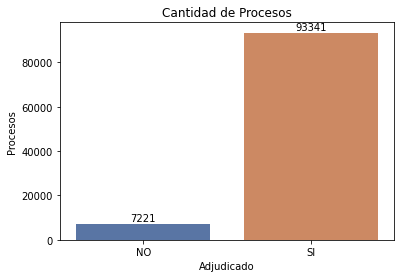

In [16]:
print(df['ID_ADJUDICACION'].value_counts())
df_group=df.groupby('ID_ADJUDICACION').count().reset_index()

g = sns.barplot(x='ID_ADJUDICACION',y='ID_CONTRATO',data=df_group, palette='deep')
g.set(title = 'Cantidad de Procesos', xlabel = 'Adjudicado', ylabel = 'Procesos')

for index, row in df_group.iterrows():
  g.text(row.name,row['ID_CONTRATO']+1000, str(row['ID_CONTRATO']), color='black', ha="center")
plt.show()


ID_ADJUDICACION
NO   0.8
SI   7.3
Name: VALOR_PROCESO, dtype: float64


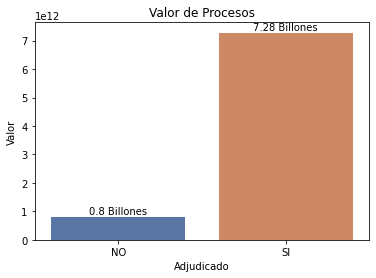

In [17]:
print(df.groupby('ID_ADJUDICACION').sum()['VALOR_PROCESO']/(10**12) ) #Billones
df_group = df.groupby('ID_ADJUDICACION').sum().reset_index()

g = sns.barplot(x='ID_ADJUDICACION',y='VALOR_PROCESO',data=df_group, palette='deep')
g.set(title = 'Valor de Procesos', xlabel = 'Adjudicado', ylabel = 'Valor')

for index, row in df_group.iterrows():
  g.text(row.name,row['VALOR_PROCESO'] + 10**11, str(round(row['VALOR_PROCESO']/(10**12) ,2))+ " Billones", color='black', ha="center")
plt.show()

* De todos los procesos, ¿Por cuál modalidad es donde se realiza una mayor contratación?

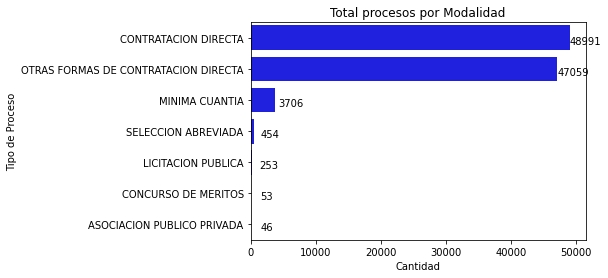

In [18]:
#print(df.groupby('MODALIDAD').sum()['VALOR_PROCESO']/(10**6) ) #MILLONES
df_group = df.groupby('MODALIDAD').count().sort_values("ID_CONTRATO", ascending=False).reset_index()
g = sns.barplot(x='ID_CONTRATO', y='MODALIDAD', data=df_group, color='b', order=df_group.sort_values('ID_CONTRATO', ascending=False).MODALIDAD)
g.set(title = 'Total procesos por Modalidad', xlabel = 'Cantidad', ylabel = 'Tipo de Proceso')

ma = max(df_group['ID_CONTRATO'])
for index, row in df_group.iterrows():
  g.text(row['ID_CONTRATO']+ ma*0.05, row.name + 0.2, row['ID_CONTRATO'], color='black', ha="center")
plt.show()

* ¿Cómo se distribuyen los procesos que aún estan por adjudicar por Modalidad?

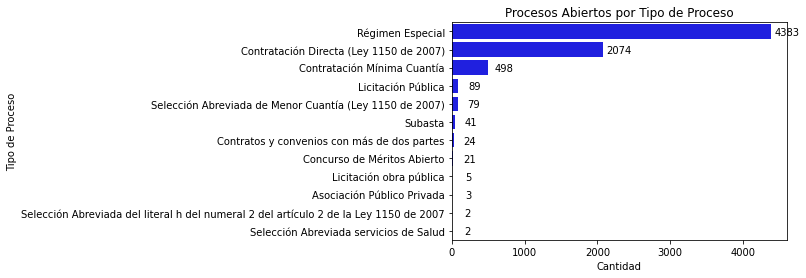

In [19]:
df_group = df[df['ID_ADJUDICACION']=='NO'].groupby('TIPO_PROCESO').count().sort_values("ID_CONTRATO", ascending=False).reset_index()

g = sns.barplot(x='ID_CONTRATO',y='TIPO_PROCESO',data=df_group, color='b')
g.set(title = 'Procesos Abiertos por Tipo de Proceso', xlabel = 'Cantidad', ylabel = 'Tipo de Proceso')

ma = max(df_group['ID_CONTRATO'])
for index, row in df_group.iterrows():
  g.text(row['ID_CONTRATO']+ ma*0.05, row.name + 0.2, row['ID_CONTRATO'], color='black', ha="center")
plt.show()

Entrando en más detalle, para cada uno de los tipos de procesos, se encuentra que contratación directa y regimen especial se llevan la mator parte de los procesos adjudicadas a la fecha. Estos procesos presentan menos tiempos en la etapa precontractual, y no estan obligados a presetar garantias de multiples oferentes, lo cual conlleva un riesgo que la contratación pública se esté dirigiendo a ciertos contratistas.

_______________
_______________

A partir de este punto nos interesa solo el conjunto de datos de los procesos adjudicados.  
Son aquellos que ya tienen contrato, contratista y fecha de suscripción.


In [20]:
df_ini = df.copy()
df = df[df['ID_ADJUDICACION']=='SI']
df.shape

(93341, 38)

#Fechas de cargue y suscripción
Se supone que por ley 1150 las entidades deben registrar la información en SECOP dentro de los 5 días siguientes. Vamos a ver como se comportan las variables Fecha de Cargue en el secop y fecha de suscripción del contrato.

Fecha Firma - Fecha Cargue > 0  --> Firmaron despues del cargue
Fecha Firma - Fecha Cargue < 0  --> Cargue despues de la firma


In [21]:
df['MODALIDAD'].value_counts()

CONTRATACION DIRECTA                    46917
OTRAS FORMAS DE CONTRATACION DIRECTA    42652
MINIMA CUANTIA                           3208
SELECCION ABREVIADA                       330
LICITACION PUBLICA                        159
ASOCIACION PUBLICO PRIVADA                 43
CONCURSO DE MERITOS                        32
Name: MODALIDAD, dtype: int64

In [22]:
df['TIEMPO_FECHAS'].value_counts()

-5.0      8927
-3.0      8499
-2.0      7326
-6.0      7182
-1.0      5544
          ... 
-518.0       1
-998.0       1
127.0        1
-500.0       1
252.0        1
Name: TIEMPO_FECHAS, Length: 733, dtype: int64

In [23]:
#df_show = df.sample(n=100000)

In [24]:

fig = px.box(data_frame=df, y='TIEMPO_FECHAS',x='MODALIDAD',
             hover_name='MODALIDAD', 
             hover_data=['ID_PROCESO','TIEMPO_FECHAS','FECHA_PUBLICACION','FECHA_SUSCRIPCION'],
             template='ggplot2'
            )
fig.update_layout(
    title= "Diferencia días Fecha Carga y Suscripción por Modalidad",
    xaxis_title="Modalidad",
    yaxis_title="Días de Diferencia"
)    
fig.show()

In [25]:
pd.set_option('display.max_colwidth', 100)
df[['ID_CONTRATO', 'URL', 'FECHA_PUBLICACION','FECHA_SUSCRIPCION', 'MODALIDAD', 'TIEMPO_FECHAS']].sort_values('TIEMPO_FECHAS').head(5)

,ID_CONTRATO,URL,FECHA_PUBLICACION,FECHA_SUSCRIPCION,MODALIDAD,TIEMPO_FECHAS
12041,20-12-10261388-9393857,https://www.contratos.gov.co/consultas/detalleProceso.do?numConstancia=20-12-10261388,2020-01-07,2007-06-06,CONTRATACION DIRECTA,"-4,598.0"
9158,20-12-10261144-9393755,https://www.contratos.gov.co/consultas/detalleProceso.do?numConstancia=20-12-10261144,2020-01-07,2007-08-31,CONTRATACION DIRECTA,"-4,512.0"
28075,20-12-10280398-9412307,https://www.contratos.gov.co/consultas/detalleProceso.do?numConstancia=20-12-10280398,2020-01-13,2007-11-01,CONTRATACION DIRECTA,"-4,456.0"
57042,20-4-10311870-9616467,https://www.contratos.gov.co/consultas/detalleProceso.do?numConstancia=20-4-10311870,2020-01-21,2009-05-15,OTRAS FORMAS DE CONTRATACION DIRECTA,"-3,903.0"
9274,20-12-10261659-9394103,https://www.contratos.gov.co/consultas/detalleProceso.do?numConstancia=20-12-10261659,2020-01-07,2009-06-03,CONTRATACION DIRECTA,"-3,870.0"


Se observa como los procesos de contratación directa y otras formad de contratación directa presentan una mayor generación de fechas re registro atípicas, se registra el contrato en SECOP 13 años después de su ejecución, lo cual genera un riesgo alto ya es no se hace un control social, y posiblemente no hayan sido parte de los procesos de auditoria.  

Por otra parte, se encuentra que hay procesos de licitación pública que se pueden demorar hasta 130 días en la adjudicación, un poco más de 4 meses.   
Estos tiempos son un poco más lasrgos que los expuestos por la ley 1150 (2 meses) ya que en la práctica, se presentan observaciones a los procesos que alargan los tiempos.

In [26]:
df['registro_tarde'] = df['TIEMPO_FECHAS'].apply(lambda x : "SI" if x < -5 else "NO")


SI    50329
NO    43012
Name: registro_tarde, dtype: int64


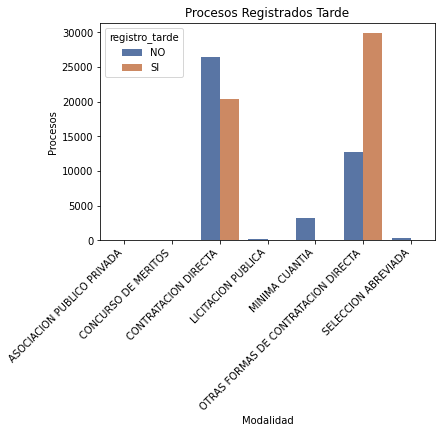

In [27]:
print(df['registro_tarde'].value_counts())
df_group=df.groupby(['registro_tarde','MODALIDAD']).count().reset_index()
df_group.head(20)

g = sns.barplot(x='MODALIDAD',y='ID_CONTRATO', hue="registro_tarde",
                data=df_group, palette='deep')
g.set(title = 'Procesos Registrados Tarde', xlabel = 'Modalidad', ylabel = 'Procesos')

g.set_xticklabels(g.get_xticklabels(), rotation=45, horizontalalignment='right')

plt.show()


Se generan alertas a razón de un registro tarde dentro del sistema, la contratación directa, y otras formas de contratación directa son las que más alertas presentan.

#Relación entre Tipo Contrato y Modalidad

¿Cuáles son los tipos de contratos que se realizan para cada una de las modalidades?

In [28]:
df_group = df.groupby(['TIPO_PROCESO','TIPO_CONTRATO']).count().reset_index()[['ID_CONTRATO','TIPO_PROCESO','TIPO_CONTRATO']]
df_group.sort_values('ID_CONTRATO',ascending=False).head(5)


,ID_CONTRATO,TIPO_PROCESO,TIPO_CONTRATO
37,"44,297.0",Contratación Directa (Ley 1150 de 2007),PRESTACION DE SERVICIOS
102,"32,819.0",Régimen Especial,PRESTACION DE SERVICIOS
103,"5,724.0",Régimen Especial,SUMINISTRO
101,"1,706.0",Régimen Especial,OTRO
51,"1,341.0",Contratación Mínima Cuantía,SUMINISTRO


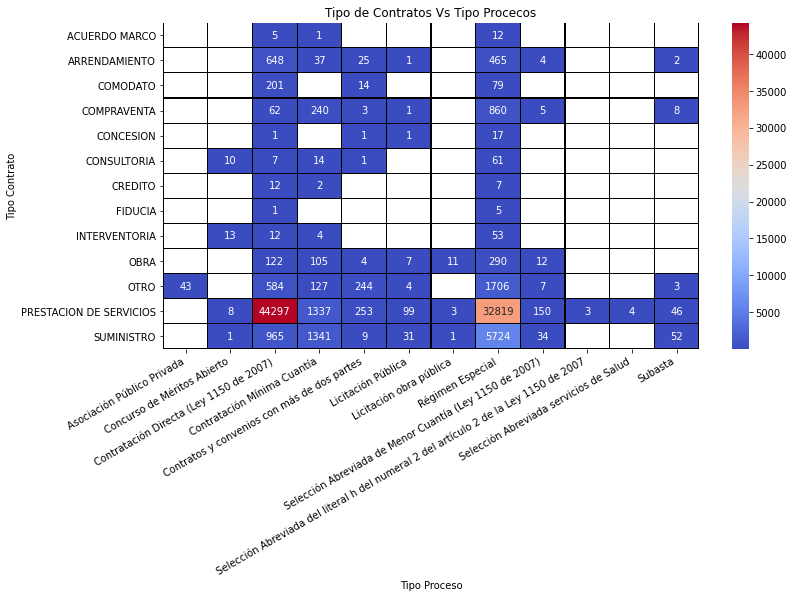

In [29]:
df_pivot = df_group.pivot_table(values='ID_CONTRATO',index=['TIPO_CONTRATO'],columns=['TIPO_PROCESO'])
df_pivot.head(20)
fig, ax = plt.subplots(figsize=(12,6))         # Sample figsize in inches
g = sns.heatmap(df_pivot, cmap='coolwarm',
                annot=True,  fmt='.0f',linewidths=0.1, linecolor='black')

g.set(title = 'Tipo de Contratos Vs Tipo Procecos', xlabel = 'Tipo Proceso', ylabel = 'Tipo Contrato')

g.set_xticklabels(g.get_xticklabels(), rotation=30, horizontalalignment='right')

plt.show()

Al entrar en detalle en el tipo de contratos que se realizar de forma direecta, resalta la prestación de servicios y regimen especial.

# Contratación de las Entidades
¿Cuáles son las entidades que más han contratado este año?


In [30]:
df.columns

Index(['ID_CONTRATO', 'NOMBRE_ENTIDAD', 'NIT_ENTIDAD', 'NIVEL_ENTIDAD',
       'TIPO_PROCESO', 'TIPO_CONTRATO', 'ESTADO_PROCESO', 'FECHA_SUSCRIPCION',
       'NUMERO_CONTRATO', 'NUMERO_PROCESO', 'VALOR_CONTRATO',
       'OBJETO_CONTRATO', 'NOMBRE_CONTRATISTA', 'ID_CONTRATISTA', 'URL',
       'ORIGEN_RECURSOS', 'VALOR_PROCESO', 'FECHA_PUBLICACION',
       'ANO_PUBLICACION', 'ANO_SUSCRIPCION', 'ID_OBJETO', 'ID_REP_LEGAL',
       'NOMBRE_REP_LEGAL', 'ID_ADJUDICACION', 'PLAZO_DIAS', 'PLAZO_RANGO',
       'MUNICIPIO_ENTIDAD', 'DEPARTAMENTO_ENTIDAD', 'MUNICIPIO_EJECUCION',
       'VALOR_ADICIONES', 'VALOR_TOTAL_CONTRATO', 'TIEMPO_ADICIONES',
       'MARCA_ADICIONES', 'FECHA_CONSULTA', 'FUENTE', 'MODALIDAD',
       'ID_PROCESO', 'TIEMPO_FECHAS', 'registro_tarde'],
      dtype='object')

In [31]:
dict_agg = {'ID_CONTRATO':'count','VALOR_CONTRATO':'sum'}
df_group = df.groupby(['NOMBRE_ENTIDAD','NIVEL_ENTIDAD'])[['ID_CONTRATO','VALOR_CONTRATO']].agg(dict_agg)
df_group.reset_index(inplace=True)
df_group['VALOR_CONTRATO'] = df_group['VALOR_CONTRATO']/(10**6)
df_show = df_group.sort_values('VALOR_CONTRATO',ascending=False).rename(columns={'ID_CONTRATO':'Num_Contratos'}).head(10)
df_show

,NOMBRE_ENTIDAD,NIVEL_ENTIDAD,Num_Contratos,VALOR_CONTRATO
5901,ECOPETROL - EMPRESA COLOMBIANA DE PETROLEOS,NACIONAL,87,"621,625.8"
1739,BOGOTA DC - EMPRESA DE ACUEDUCTO Y ALCANTARILLADO,TERRITORIAL,129,"454,192.2"
977,ANTIOQUIA - ESE HOSPITAL SAN RAFAEL - YOLOMBO,TERRITORIAL,167,"312,027.1"
422,ANTIOQUIA - ALIANZA MEDELLIN ANTIOQUIA EPS SAS,TERRITORIAL,35,"141,824.1"
10316,VALLE DEL CAUCA - ALCALDIA MUNICIPIO DE YUMBO,TERRITORIAL,257,"139,002.9"
10502,VALLE DEL CAUCA - GOBERNACION,TERRITORIAL,928,"118,678.5"
5909,ELECTRIFICADORA DEL HUILA,TERRITORIAL,8,"114,440.9"
7109,NARIÑO - ALCALDIA MUNICIPIO DE LEIVA,TERRITORIAL,7,"105,091.1"
1503,ARMADA NACIONAL DE LA REPUBLICA DE COLOMBIA,NACIONAL,5,"100,689.5"
9095,SANTANDER - ESE NUESTRA SEÑORA DE LA PAZ - LA PAZ,TERRITORIAL,14,"99,263.6"


In [32]:
df_show = df_show.sort_values('VALOR_CONTRATO',ascending=True)

fig = px.bar(data_frame=df_show, x='VALOR_CONTRATO',y='NOMBRE_ENTIDAD', 
             orientation='h',
             hover_name='NOMBRE_ENTIDAD', 
             hover_data=['NIVEL_ENTIDAD','Num_Contratos'],

             template='ggplot2'
            )
fig.update_layout(
    title= "Contratación Entidades",
    xaxis_title="Valor en millones",
    yaxis_title=""
)    
fig.show()

/usr/local/lib/python3.6/dist-packages/plotly/express/_core.py:286: FutureWarning:

Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.



# Analisis de concentración de contratos

* ¿Qué contratista tiene una mayor cantidad de contratos y por valor de los mismos?
* ¿Exsite relacion ente diferentes representantes legales y empresas?

In [33]:
dict_agg = {'ID_CONTRATO':'count','NOMBRE_CONTRATISTA':'max','VALOR_CONTRATO':'sum'}
df_group = df.groupby(['ID_CONTRATISTA'])[['ID_CONTRATO','NOMBRE_CONTRATISTA','VALOR_CONTRATO']].agg(dict_agg)

df_group.reset_index(inplace=True)
df_group['VALOR_CONTRATO'] =df_group['VALOR_CONTRATO']/(10**6)
df_show = df_group.sort_values('VALOR_CONTRATO',ascending=False).rename(columns={'ID_CONTRATO':'Num_Contratos'}).head(10)
df_show
#df_group.head()

,ID_CONTRATISTA,Num_Contratos,NOMBRE_CONTRATISTA,VALOR_CONTRATO
65848,830069311,1,NABORS DRILLING INTERNATIONAL LTD - BERMUDA,"487,500.0"
49509,43507565,2,ADRIANA JUDITH RONCALLO OSSA,"310,060.0"
73889,901348231,1,CONSORCIO ALIANZA 744,"262,616.1"
68550,890903938,5,BANCOLOMBIA SA,"112,624.3"
70865,900483991,2,AGENCIA NACIONAL INMOBILIARIA VIRGILIO BARCO VARGAS,"109,205.4"
69658,900193766,1,CENTRO DE SALUD SAN JOSE DE LEIVA ESE,"105,000.0"
68401,890399003,9,EMPRESAS MUNICIPALES DE CALI EICE ESP EMCALI,"90,201.1"
70923,900494981,6,DARSALUD AT,"81,481.2"
64249,805012896,7,INDERVALLE,"66,009.5"
56148,6387014,1,JULIAN ARTURO POLO ECHEVERRI,"63,250.0"


In [34]:
df_show = df_show.sort_values('VALOR_CONTRATO',ascending=True)

fig = px.bar(data_frame=df_show, x='VALOR_CONTRATO',y='NOMBRE_CONTRATISTA', 
             orientation='h',
             hover_name='NOMBRE_CONTRATISTA', 
             hover_data=['ID_CONTRATISTA','Num_Contratos'],

             template='ggplot2'
            )
fig.update_layout(
    title= "Contratación Contratistas",
    xaxis_title="Valor en millones",
    yaxis_title=""
)    
fig.show()

# Valor Proceso y Valor Contrato

In [35]:
df_data = df.copy(deep=True)

df_data['VALOR_CONTRATO'] = df_data['VALOR_CONTRATO']/(10**6)
df_data['VALOR_PROCESO'] = df_data['VALOR_PROCESO']/(10**6)

df_data.head()


,ID_CONTRATO,NOMBRE_ENTIDAD,NIT_ENTIDAD,NIVEL_ENTIDAD,TIPO_PROCESO,TIPO_CONTRATO,ESTADO_PROCESO,FECHA_SUSCRIPCION,NUMERO_CONTRATO,NUMERO_PROCESO,VALOR_CONTRATO,OBJETO_CONTRATO,NOMBRE_CONTRATISTA,ID_CONTRATISTA,URL,ORIGEN_RECURSOS,VALOR_PROCESO,FECHA_PUBLICACION,ANO_PUBLICACION,ANO_SUSCRIPCION,ID_OBJETO,ID_REP_LEGAL,NOMBRE_REP_LEGAL,ID_ADJUDICACION,PLAZO_DIAS,PLAZO_RANGO,MUNICIPIO_ENTIDAD,DEPARTAMENTO_ENTIDAD,MUNICIPIO_EJECUCION,VALOR_ADICIONES,VALOR_TOTAL_CONTRATO,TIEMPO_ADICIONES,MARCA_ADICIONES,FECHA_CONSULTA,FUENTE,MODALIDAD,ID_PROCESO,TIEMPO_FECHAS,registro_tarde
0,20-4-10247786-9380559,ANTIOQUIA - ESE HOSPITAL SAN JUAN DE DIOS DE YARUMAL,890981726,TERRITORIAL,Régimen Especial,PRESTACION DE SERVICIOS,CELEBRADO,2020-01-02,CPS-017-2020,CPS-017-2020,78.0,TRANSPORTE,LINA MARIA MADRIGAL MARTINEZ,32561155,https://www.contratos.gov.co/consultas/detalleProceso.do?numConstancia=20-4-10247786,NO DEFINIDO,78.0,2020-01-01,2020,2020,78000000,32561155,PROPIO 1,SI,360,M,YARUMAL,ANTIOQUIA,ANTIOQUIA - YARUMAL,0,78000000,0,No,2020-11-27 12:30:03.589442,SECOP_I,OTRAS FORMAS DE CONTRATACION DIRECTA,20-4-10247786,1.0,NO
1,20-12-10247879-9380671,TOLIMA - ALCALDIA MUNICIPIO DE EL ESPINAL,890702027,TERRITORIAL,Contratación Directa (Ley 1150 de 2007),PRESTACION DE SERVICIOS,CELEBRADO,2019-11-15,703,703-2019,3.3,PRESTACION DE SERVICIOS PROFESIONALES PARA EJECUTAR LAS ACCIONES CORRESPONDIENTES EN SALUD INCLU...,JERSON CAMILO BRAVO MONTENEGRO,1024528707,https://www.contratos.gov.co/consultas/detalleProceso.do?numConstancia=20-12-10247879,NO DEFINIDO,3.3,2020-01-01,2020,2019,80000000,1024528707,JERSON CAMILO BRAVO MONTENEGRO,SI,45,D,EL ESPINAL,TOLIMA,TOLIMA - EL ESPINAL,0,3333333,0,No,2020-11-27 12:30:03.589442,SECOP_I,CONTRATACION DIRECTA,20-12-10247879,-47.0,SI
3,20-4-10247830-9380768,NORTE DE SANTANDER - UNIVERSIDAD FRANCISCO DE PAULA SANTANDER DE CUCUTA,890500622,TERRITORIAL,Régimen Especial,PRESTACION DE SERVICIOS,CELEBRADO,2020-01-01,OPSF00005,OPS-F00005,1.5,PRESTACION DE SERVICIOS DE UN TECNOLOGO EN OBRAS CIVILES PARA EL DESARROLLO DE LAS DIFERENTES PR...,VEGA HERNANDEZ JOSE IGNACIO,13474088,https://www.contratos.gov.co/consultas/detalleProceso.do?numConstancia=20-4-10247830,NO DEFINIDO,1.5,2020-01-01,2020,2020,80000000,13474088,VEGA HERNANDEZ JOSE IGNACIO,SI,19,D,SAN JOSE DE CUCUTA,NORTE DE SANTANDER,NORTE DE SANTANDER - SAN JOSE DE CUCUTA,0,1500000,0,No,2020-11-27 12:30:03.589442,SECOP_I,OTRAS FORMAS DE CONTRATACION DIRECTA,20-4-10247830,0.0,NO
4,20-12-10247987-9380802,TOLIMA - ALCALDIA MUNICIPIO DE EL ESPINAL,890702027,TERRITORIAL,Contratación Directa (Ley 1150 de 2007),PRESTACION DE SERVICIOS,CELEBRADO,2019-11-15,715,715-2019,1.9,PRESTACION DE SERVICIOS DE APOYO A LA GESTION PARA LA CONSERVACION PRESERVACION Y CUSTODIA DE LA...,JENIFFER RODRIGUEZ PEREZ,1105683306,https://www.contratos.gov.co/consultas/detalleProceso.do?numConstancia=20-12-10247987,NO DEFINIDO,1.9,2020-01-01,2020,2019,80000000,1105683306,JENIFFER RODRIGUEZ PEREZ,SI,47,D,EL ESPINAL,TOLIMA,TOLIMA - EL ESPINAL,0,1880000,0,No,2020-11-27 12:30:03.589442,SECOP_I,CONTRATACION DIRECTA,20-12-10247987,-47.0,SI
5,20-13-10247969-9388537,NORTE DE SANTANDER - ALCALDIA MUNICIPIO DE GRAMALOTE,890501404,TERRITORIAL,Contratación Mínima Cuantía,SUMINISTRO,CELEBRADO,2020-01-04,CONTRATO DE SUMINISTRO 009 DE 2020,MINIMA CUANTIA NO 003 DE 2020,4.5,APOYO LOGISTICO PARA LA FUERZA PUBLICA QUE REFORZARA LA SEGURIDAD EN EL MARCO DE LAS ACTIVIDADES...,HENRY ESCALANTE MORA,88168893,https://www.contratos.gov.co/consultas/detalleProceso.do?numConstancia=20-13-10247969,NO DEFINIDO,4.5,2020-01-01,2020,2020,80000000,88168893,HENRY ESCALANTE MORA,SI,4,D,GRAMALOTE,NORTE DE SANTANDER,NORTE DE SANTANDER - GRAMALOTE,0,4500000,0,No,2020-11-27 12:30:03.589442,SECOP_I,MINIMA CUANTIA,20-13-10247969,3.0,NO


In [36]:
#df_data = df_data.sample(n=100000)
fig = px.scatter(data_frame=df_data, x='VALOR_PROCESO',y='VALOR_CONTRATO',
                 color='MODALIDAD',
                 hover_name='MODALIDAD', 
                 hover_data=['ID_PROCESO','NOMBRE_ENTIDAD'],
                 template='ggplot2'
            )
fig.update_layout(
    title= "Valor Proceso Vs Valor Contrato",
    xaxis_title="Valor Contrato en millones",
    yaxis_title="Valor Proceso en Millones"
)    
fig.show()

La variable valor del proceso, es el valor por el cual inica el proceso de contratación y al momento de la firma el contrato se ajusta por diferentes motivos, se espera que estas variables presenten una correlación directa e incluso sean iguales en la mayoria de los casos.  
al analizar en detalle se observa que entre estos ocurre una relación de 10 o 100 veces, lo que indica que al momento del registro, las personas agregan  uno 2 o tres ceros de más.

# Correlación de Variables

A continuación realizaremos un analisis de correlación entre las variables númericas

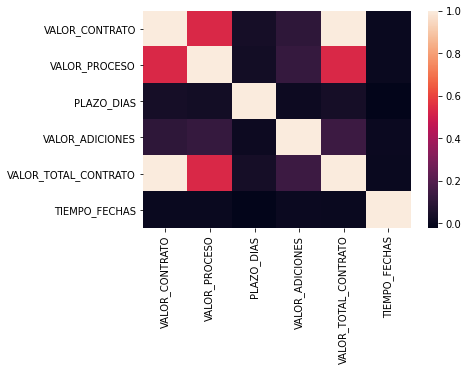

In [37]:
import seaborn as sns

sns.heatmap(df.corr())

# Fechas de frima de Contrato

Ahora buscamos analizar los las fechas de firmas de contratos de los contratos adjudicados en el 2020. Por lo cual haremos un dataFrame de solo lo adjudicado en 2020 y lo graficaremos en una linea de serie temporal en cuanto a Cuantia de Contrato

In [38]:
import numpy as np
%matplotlib inline
import cufflinks as cf
print(cf.__version__)
# cf version 0.17.0 OK
cf.set_config_file(offline=True)
import plotly
plotly.__version__
# Plotly 4.4.1 OK
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))

0.17.3


In [39]:
configure_plotly_browser_state()
df = df.sort_values(['FECHA_SUSCRIPCION'])
df_Adj_Grp_2 = df.groupby(['FECHA_SUSCRIPCION']).sum()['VALOR_CONTRATO']
df_Adj_Grp_2.dtypes
df_Adj_Grp_2.iplot(kind='line',y='VALOR_CONTRATO')